In [1]:
import os
import tensorflow as tf
from google.protobuf import text_format
from protos import pipeline_pb2
from modeling import trainer

image_dir = "/afs/cs.pitt.edu/usr0/key36/work2/WSSGG/data-vspnet/images"
model_dir = "/afs/cs.pitt.edu/usr0/key36/work2/WSSGG/logs/ws_prop50_drop0.8_adam0.00001"
config_file = os.path.join(model_dir, "pipeline.pbtxt")

for gpu in tf.config.experimental.list_physical_devices('GPU'):
  tf.config.experimental.set_memory_growth(gpu, True)

with tf.io.gfile.GFile(config_file, 'r') as fp: 
  pipeline_proto = text_format.Merge(fp.read(), pipeline_pb2.Pipeline())
batch_generator = trainer.predict(pipeline_proto, model_dir)

W0911 13:34:04.323975 140288034182976 model_fn.py:630] Estimator's model_fn (<function _create_model_fn.<locals>._model_fn at 0x7f96701266a8>) includes params argument, but params are not passed to Estimator.
W0911 13:34:04.797096 140288034182976 module_wrapper.py:139] From /afs/cs.pitt.edu/projects/kovashka/keren3/WSSGG/python/lib/python3.6/site-packages/tensorflow_core/python/autograph/converters/directives.py:119: The name tf.parse_single_example is deprecated. Please use tf.io.parse_single_example instead.

W0911 13:34:04.800203 140288034182976 module_wrapper.py:139] From /afs/cs.pitt.edu/projects/kovashka/keren3/WSSGG/python/lib/python3.6/site-packages/tensorflow_core/python/autograph/converters/directives.py:119: The name tf.sparse_tensor_to_dense is deprecated. Please use tf.sparse.to_dense instead.

W0911 13:34:05.659818 140288034182976 deprecation.py:323] From /afs/cs.pitt.edu/projects/kovashka/keren3/WSSGG/python/lib/python3.6/site-packages/tensorflow_core/contrib/layers/pyth

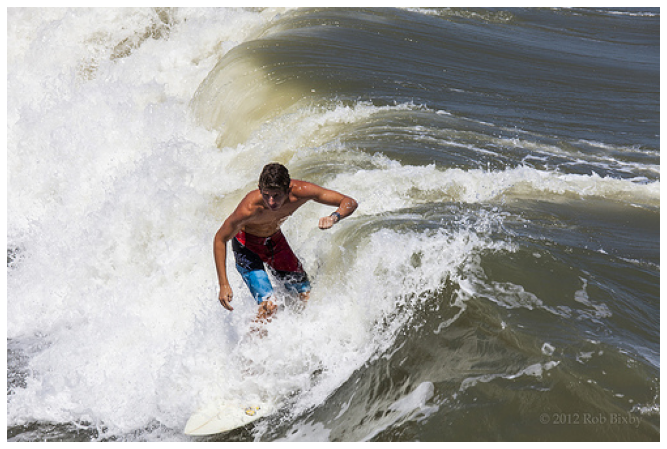

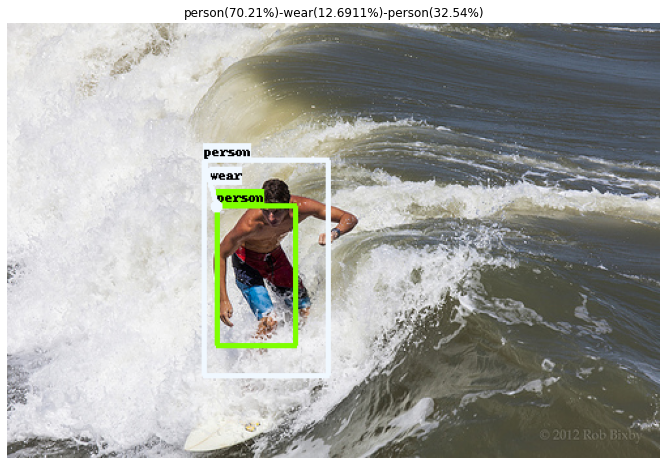

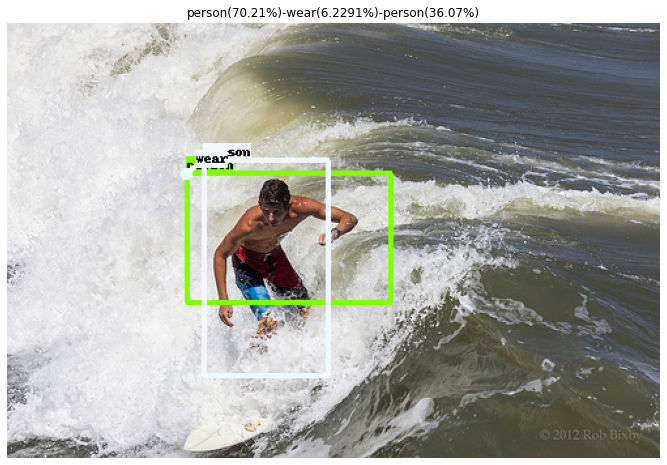

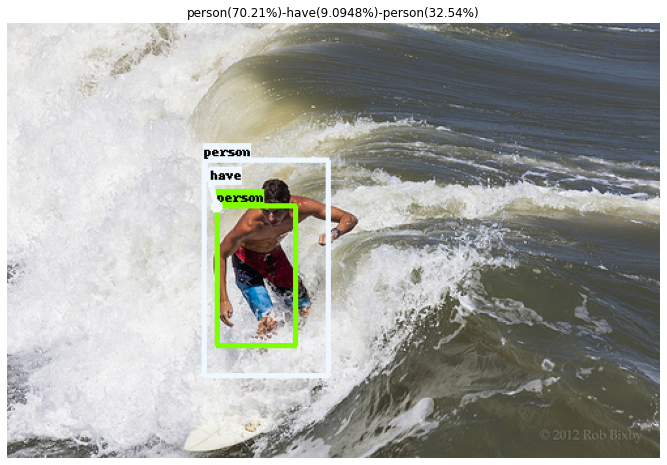

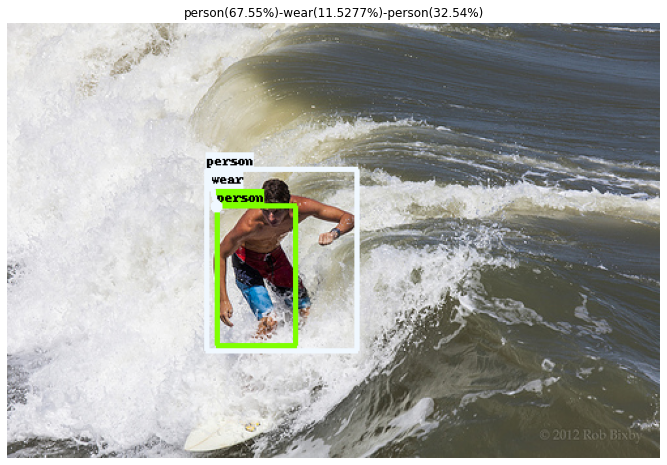

...

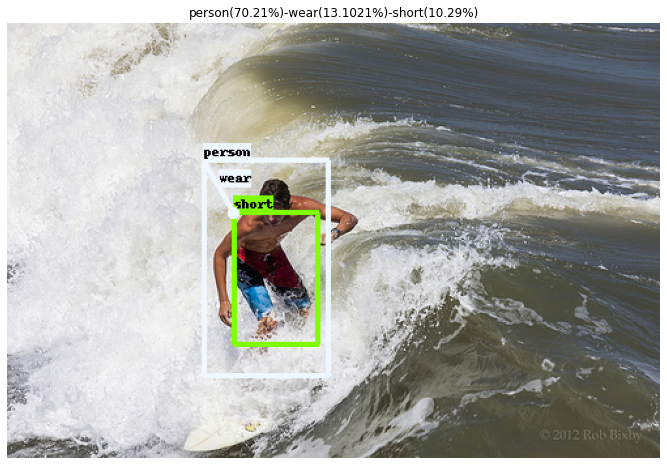

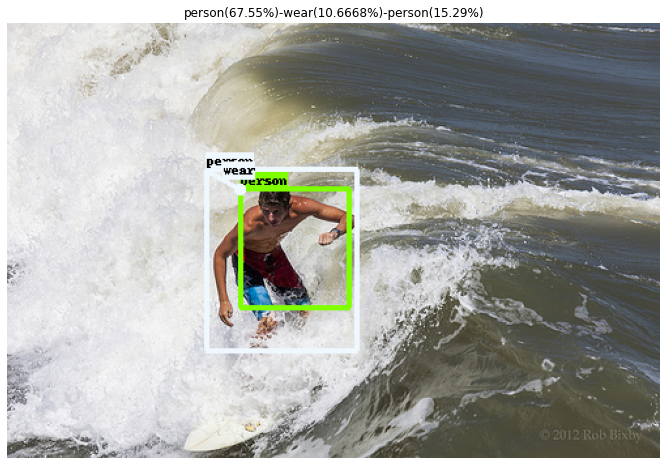

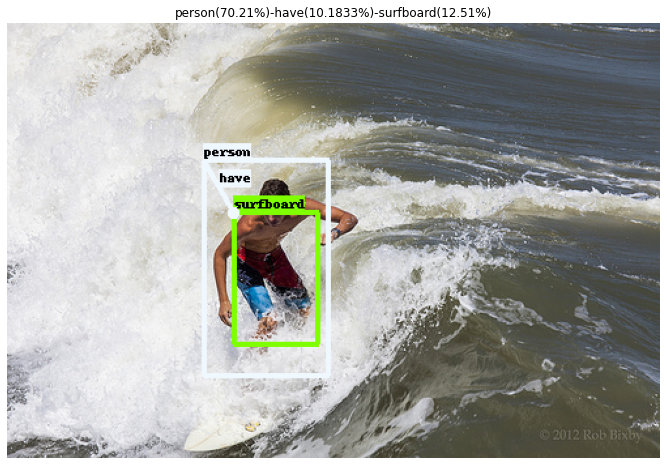

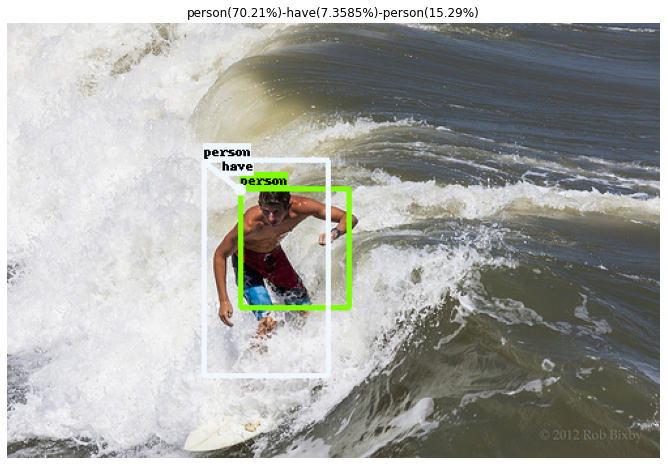

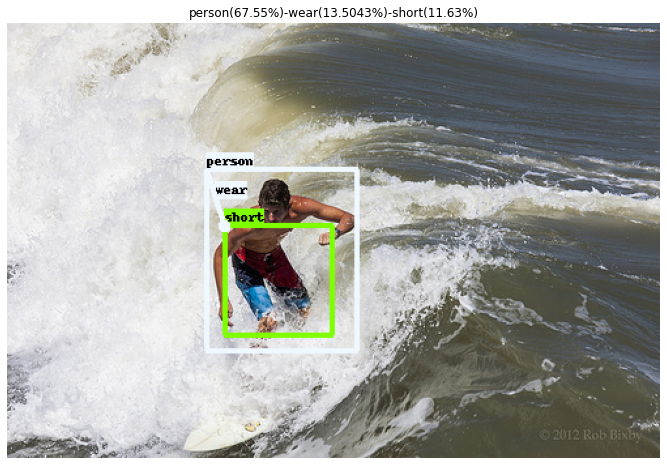

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import PIL.Image as Image
from modeling.utils import visualization

%matplotlib inline

try:
  i = next(example_id_generator)
except Exception as ex:
  example = next(batch_generator)
  example_id_generator = (i for i in range(len(example['id'])))
  i = next(example_id_generator)

image_id = example['id'][i]
n_proposal = example['image/n_proposal'][i]
proposals = example['image/proposal'][i]

# Ground-truth information.
subjects = example['beam_search/subject'][i]
subject_boxes = example['beam_search/subject/box'][i]
subject_scores = example['beam_search/subject/score'][i]
predicates = example['beam_search/predicate'][i]
predicate_scores = example['beam_search/predicate/score'][i]
objects = example['beam_search/object'][i]
object_boxes = example['beam_search/object/box'][i]
object_scores = example['beam_search/object/score'][i]

# Load original image.
image = Image.open(os.path.join(image_dir, '%i.jpg' % image_id))
image = np.array(image)

# Show original image.
plt.figure(figsize=(16, 8))
plt.subplot(1, 1, 1)
plt.imshow(image)
plt.axis('off')


# Show ground-truth and predicted tuples.
for pred_id, (pred, pred_score, sub, sub_box, sub_score, obj, obj_box, obj_score) in enumerate(
    zip(predicates, predicate_scores, subjects, subject_boxes, subject_scores, objects, object_boxes, object_scores)):

  plt.figure(figsize=(16, 8))
    
  # Prediction.
  plt.subplot(1, 1, 1).set_title("%s(%.2lf%%)-%s(%.4lf%%)-%s(%.2lf%%)" % (
      sub.decode('ascii'), 100 * sub_score, 
      pred.decode('ascii'), 100 * pred_score, 
      obj.decode('ascii'), 100 * obj_score))
  image_with_prediction = visualization.draw_bounding_box_py_func_fn(
      image.copy(), 2, [sub_box, obj_box], [sub, obj], None)
  image_with_prediction = visualization.draw_arrow_py_func_fn(
      image_with_prediction, 1, [sub_box[0]], [sub_box[1]], [obj_box[0]], [obj_box[1]], [pred], None)
  plt.imshow(image_with_prediction)
  plt.axis('off')
    